# LPJ-GUESS CLM comparison

This notebook aims to convert the LPJGUESS pfts into the CLM ones, using graphical comparison.

In [1]:
import numpy as np
import pandas as pd
import xarray as xr; xr.set_options(keep_attrs=True)
import matplotlib as mpl
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import proplot

import sys; sys.path.append("..")
from dataset_manipulation import *
from surfdatamaplib import *
from lpjguess import *

In [2]:
# Paths to the data:
foldername = '../../data/LPJ-GUESS/'
folder_out='/Users/adelezaini/Desktop/master-thesis/processed-data/input/'
fn = 'fpc1971to2000.txt' # historical data
fn_path = foldername+'FPC/'+fn

## Covered area in LPJ-GUESS study

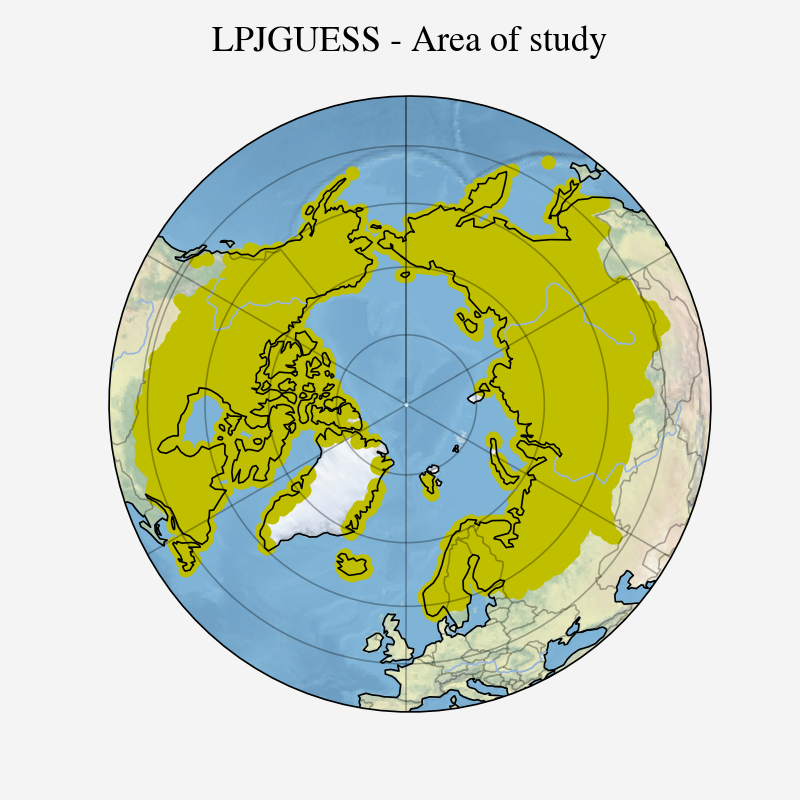

In [3]:
# Import the gridlist (lon-lat lists)
fn = 'gridlist45N_tundraboreal.txt'
lonlat = pd.read_csv(foldername+fn, sep="\t", header=None)
# Name the un-named columns
lonlat.columns = ['Lon', 'Lat']
#data.columns = ['LONGXY', 'LATIXY'] #data = data.to_xarray()

# Plot the study area
fig = plt.figure(1, figsize=[4,4])
ax = plt.axes(projection=ccrs.Orthographic(0, 90))
cut_extent_Orthographic(ax, lat=40)

lonlat.plot.scatter(ax=ax, x='Lon', y='Lat', transform = ccrs.PlateCarree(), color='y')
ax_map_properties(ax, earth=True, gridlines=True)
ax.set_title("LPJGUESS - Area of study",y=1.05,size='x-large') #, y=1.15, #plt.tight_layout()
plt.show()

## Differences in grid resolution and covered area

*Note:* For CLM a selection of PFT has been applied, otherwise the Total would give allover 100%. This is because CLM includes bareground as PFT, while LPJGUESS doesn't.

In [4]:
# Load a CLM DataArray (from previous analysis)
pfts_CLM = xr.open_dataset(folder_out+'IDEALIZED/pfts_CLM.nc'); pfts_CLM = pfts_CLM.PCT_NAT_PFT
# Filter DataArray by the land cover (to have ocean grid cells marked as NaN instead of 0)
lnd_frac = xr.open_dataset(folder_out+'IDEALIZED/lndfrac_CLM.nc'); lnd_frac = lnd_frac.LANDFRAC_PFT
lnd_frac = lnd_frac.where(lnd_frac<=1.,1.) # There are values above 1. -> replace with 1.
pfts_CLM = pfts_CLM.where(lnd_frac>0.)

# Import data LPJGUESS historical data
pftstot=DataArray_from_LPJGUESS(fn_path, total = True, name='FPC_PFT', colnames=False, da_attrs=pfts_CLM,
                               main_attrs = {'long_name': 'foliage projective cover (fraction of gridcell)'})

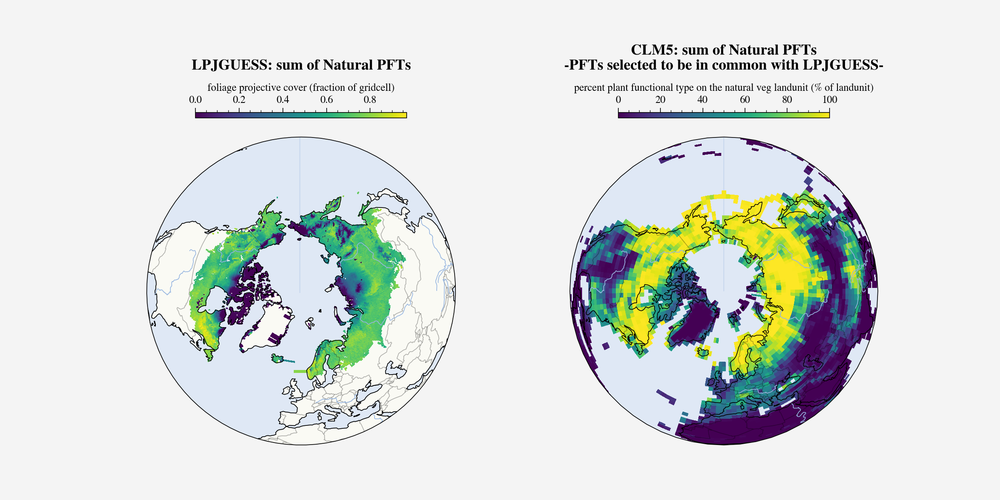

In [5]:
# Plot difference plots
fig, axs = plt.subplots(ncols=2, figsize=[12,6],subplot_kw={'projection': ccrs.Orthographic(0,90)})

single_pft_map(pftstot.isel(natpft=(-2)), title= "LPJGUESS: sum of Natural PFTs", extent_lat=20, grid=False,
               cmap='viridis', ax = axs[0])
single_pft_map(pfts_CLM.sel(natpft=[1,2,3,5,7,8,9,10,11,12]).sum('natpft', keep_attrs=True, skipna=False), 
               title= "CLM5: sum of Natural PFTs\n-PFTs selected to be in common with LPJGUESS-", grid=False,
               cmap='viridis', ax = axs[1])

## PFT comparison

In [6]:
pftnames = pftnames_LPJGUESS(foldername+'FPC/'+'fpc1971to2000.txt')
pftnames_da = xr.DataArray(pftnames, coords={'natpft':range(23)})
df1 = pftnames_da.rename('LPJGUESS study').to_dataframe()

names = {0:'Boreal needle-leaved evergreen tree', 
         1:'Boreal shade-intolerant needle-leaved evergreen tree', 
         2:'Boreal needle-leaved summergreen tree', 
         3:'Temperate needle-leaved evergreen tree', 
         4:'Temperate broad-leaved evergreen tree', 
         5:'Shade-intolerant broad-leaved summergreen tree', 
         6:'Temperate broad-leaved summergreen tree', 
         7:'Cold C3 grass', 8:'High shrub evergreen', 
         9:'High shrub summergreeen', 10:'Low shrub evergreen', 
         11:'Low shrub summergreen', 12:'Graminoid and forb tundra', 
         13:'Evergreen prostate dwarf shrub - needleleaved', 
         14:'Summergreen prostate dwarf shrub - broadleaved', 
         15:'Cushion forb, lichen and moss', 16:'?',
         17:'?',18:'?',19:'Flood-tolerant grass/gramoid',20:'Peatland moss',
         21:'?',22:'?' }
da = xr.DataArray(list(names.values()), coords={'natpft':list(names.values())})
df2 = da.assign_coords({'natpft': range(23)}).rename('LPJ-GUESS names').to_dataframe()

veg_group = {0:'tree', 1:'tree', 2:'tree', 3:'tree', 4:'tree', 5:'tree', 6:'tree', 7:'grass', 8:'shrub', 
             9:'shrub', 10:'shrub', 11:'shrub', 12:'grass', 13:'grass', 14:'grass', 15:'grass',16:'shrub?',
             17:'shrub?', 18:'grass?',19:'grass?',20:'?',21:'grass?',22:'grass?' }
da = xr.DataArray(list(veg_group.values()), coords={'natpft':list(veg_group.values())})
df3 = da.assign_coords({'natpft': range(23)}).rename('vegetation group').to_dataframe()

corr = {0:'BoNET', 1:'BoNET', 2:'BoNDT', 3:'TeNET', 4:'TeBET', 5:'BoBDT, TeBDT', 6:'TeBDT', 
        7:'C3, articC3', 8:'TeBES', 9:'BoBDS, TeBDS', 10:'TeBES', 11:'BoBDS, TeBDS', 12:'?', 13:'?', 
        14:'?', 15:'?',16:'?',17:'?',18:'?',19:'?',20:'?',21:'?',22:'?' }
da = xr.DataArray(list(corr.values()), coords={'natpft':list(corr.values())})
df4 = da.assign_coords({'natpft': range(23)}).rename('NORESM - corresp').to_dataframe()

pftnames_CLM = {0:'Bare Ground', 1:'TeNET', 2:'BoNET', 3:'BoNDT', 4:'TrBET', 5:'TeBET', 6:'TrBDT', 
             7:'TeBDT', 8:'BoBDT', 9:'TeBES', 10:'TeBDS', 11:'BoBDS', 12:'arcticC3', 13:'C3', 14:'C4'}
#da = xr.DataArray(list(pftnamesN.values()), coords={'natpft':list(pftnamesN.values())})
#df2 = da.assign_coords({'natpft': range(15)}).rename('NORESM - indexes').to_dataframe()
#noresm_indexes = ["2","2","3","1", "5", "8,10", "7","12,13", "10,11", "10,11", "10,11", "10,11"]

corr_index = {0:2, 1:2, 2:3, 3:1, 4:5, 5:(8,7), 6:7, 7:(12,13), 8:(9), 9:(10,11), 10:(9), 
              11:(10,11), 12:'?', 13:'?', 14:'?', 15:'?',16:'?',17:'?',18:'?',19:'?',20:'?',21:'?',22:'?' }
da = xr.DataArray(list(corr_index.values()), coords={'natpft':list(corr_index.values())})
df5 = da.assign_coords({'natpft': range(23)}).rename('NORESM - indexes').to_dataframe()

df = df1.merge(df2, how="left", on='natpft')
df = df.merge(df3, how="left", on='natpft')
df = df.merge(df4, how="left", on='natpft')
df = df.merge(df5, how="left", on='natpft')
display(df)

,LPJGUESS study,LPJ-GUESS names,vegetation group,NORESM - corresp,NORESM - indexes
natpft,,,,,
0,BNE,Boreal needle-leaved evergreen tree,tree,BoNET,2
1,BINE,Boreal shade-intolerant needle-leaved evergree...,tree,BoNET,2
2,BNS,Boreal needle-leaved summergreen tree,tree,BoNDT,3
3,TeNE,Temperate needle-leaved evergreen tree,tree,TeNET,1
4,TeBE,Temperate broad-leaved evergreen tree,tree,TeBET,5
5,IBS,Shade-intolerant broad-leaved summergreen tree,tree,"BoBDT, TeBDT","(8, 7)"
6,TeBS,Temperate broad-leaved summergreen tree,tree,TeBDT,7
7,C3G,Cold C3 grass,grass,"C3, articC3","(12, 13)"
8,HSE,High shrub evergreen,shrub,TeBES,9


## PFT graphical comparison
Data compared: 
- LPJGUESS Historical (1971-2000)
- CLM5 surfdata in 2000

### <span style="color:DarkSlateGray">PFTs in LPJGUESS</span>

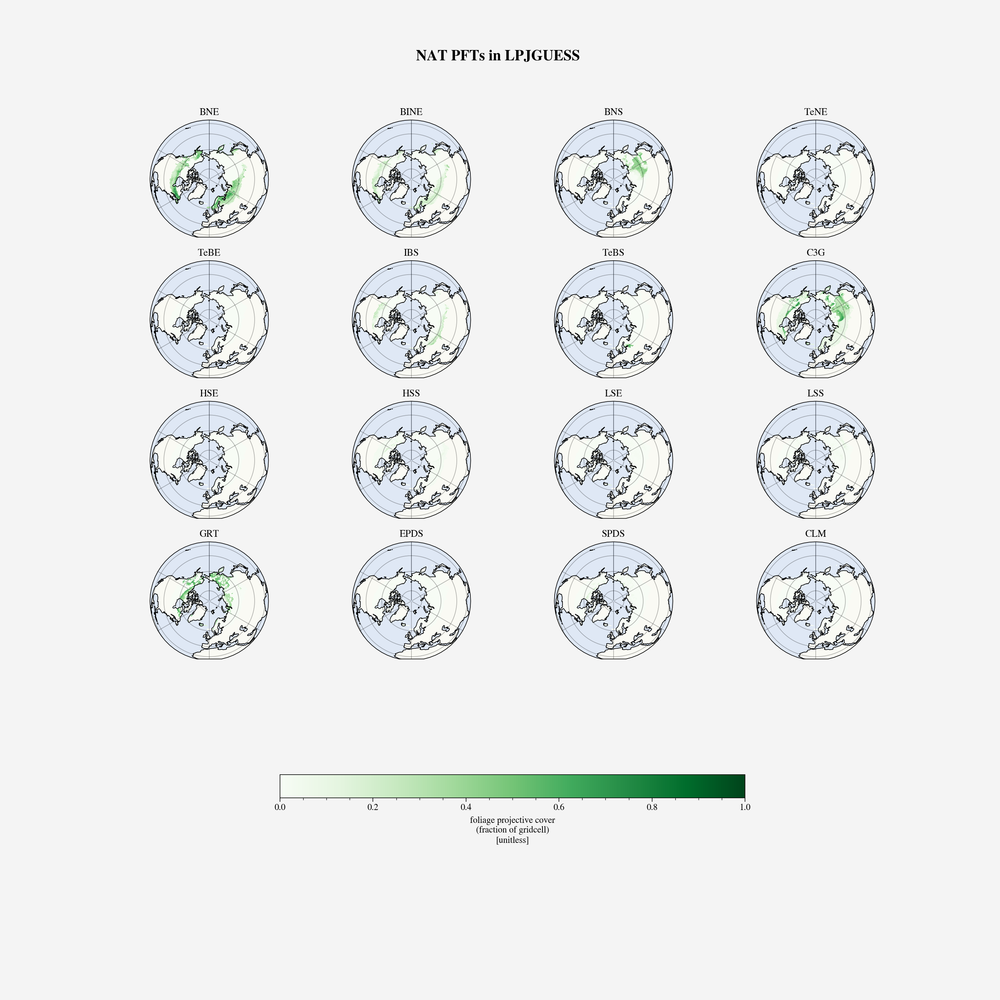

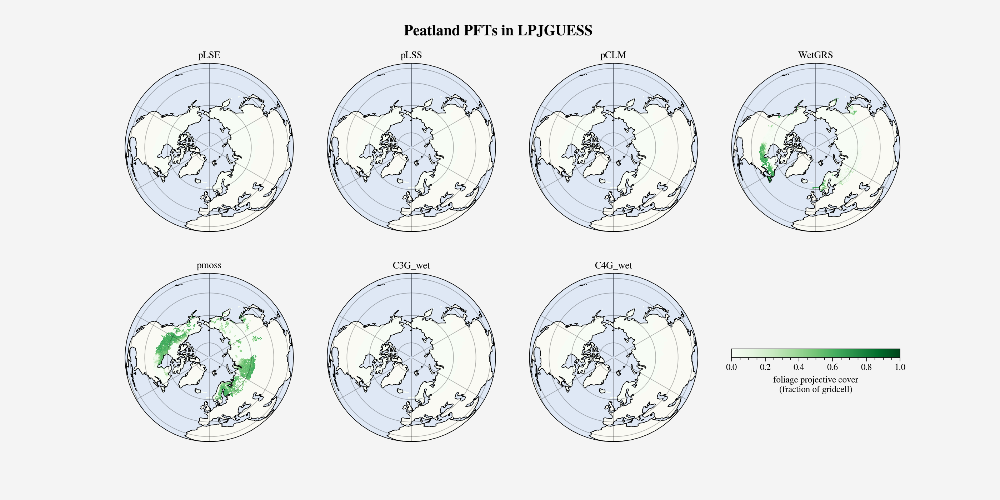

In [7]:
pfts = DataArray_from_LPJGUESS(fn_path, name='FPC_PFT', colnames=False, da_attrs=pfts_CLM,
                               main_attrs = {'long_name': 'foliage projective cover (fraction of gridcell)'})
plot_boreal_pfts(pfts.sel(natpft=slice(0,15)), titles = pftnames, col_wrap=4, 
                 title = "NAT PFTs in LPJGUESS ", lat = 0.5)#extra_cbar_axis=True)
plot_boreal_pfts(pfts.sel(natpft=slice(16,22)), titles = pftnames[16:], col_wrap=4, 
                 title = "Peatland PFTs in LPJGUESS ")

<span style="color:purple">**OBS! The peatland fraction will not be considered in the rest of the analysis - see Appendix B for further considerations**</span>

### <span style="color:DarkSlateGray">PFTs in CLM5</span>

**Note: CLM PFT fraction cover is evaluated over the landunit $\rightarrow$ CLM is then renormalized over the total grid area for the comparison**

<span style="color:purple">**OBS! Remember that in applying the replacement it is the otherway around: LPJGUESS data needs to be normalized over the landunit**</span>

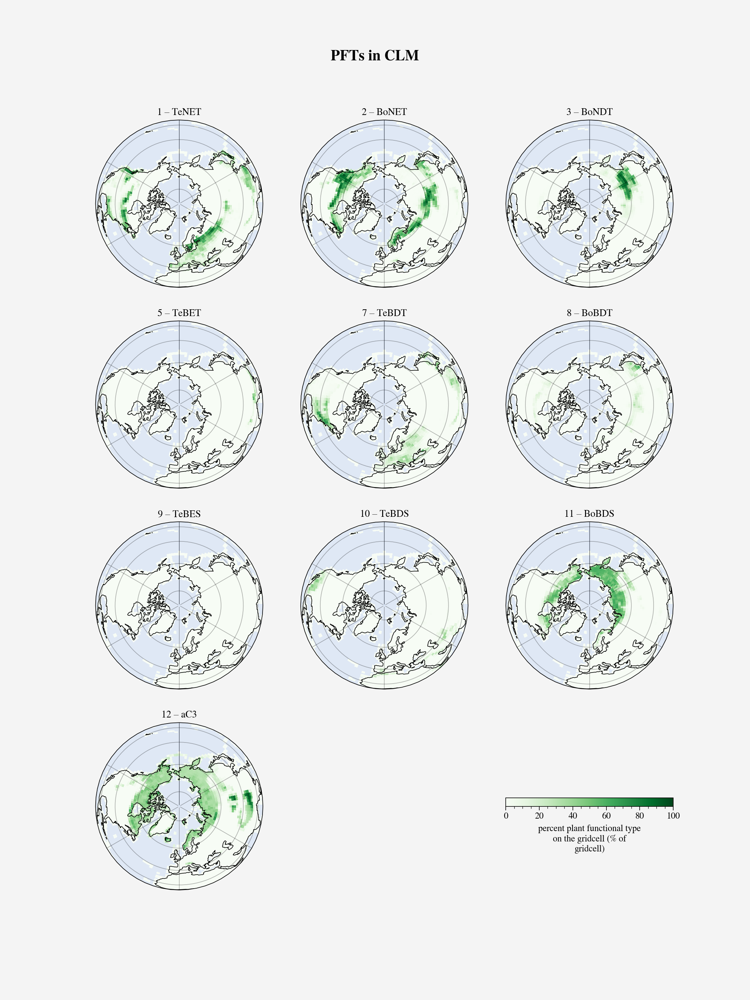

In [8]:
# Data from CLM is in landunit -> convert over the total gridcell
attrs = {'long_name': 'percent plant functional type on the gridcell (% of gridcell)'}
pfts_CLM_norm = convert_landunit_to_gridcell(pfts_CLM, lnd_frac, attrs) 
pfts_CLM_sel = pfts_CLM_norm.sel(natpft=[1,2,3,5,7,8,9,10,11,12]) #where(pfts_CLM>0.)
plot_boreal_pfts(pfts_CLM_sel,title = "PFTs in CLM", vmax=100, col_wrap=3,
                 titles = ["1 – TeNET","2 – BoNET","3 – BoNDT", "5 – TeBET", "7 – TeBDT", "8 – BoBDT", 
                           "9 – TeBES", "10 – TeBDS","11 – BoBDS","12 – aC3"])

Some are easy to convert (ex: TeNE -> TeNET), some can be just summed up (ex: BNE+BINE = BoNET, or all the evergreen shrubs), but when it comes to have multiple L. pfts matching multiple C. pfts it is not trivial.

There is not an exact correspondance between the two datasets. By comparing the plots of occurrence & vegetation group of belonging (see previous table), we can guess a classification.

**Notes:**

From vegetation group:
- IBS corresponds two PFTs of CLM (BoBDT, TeBDT)
- CLM doesn't have a boreal evergreen shrub type, while LPJ-GUESS does
- LPJ-GUESS shrubs are not divided into temperate and boreal and CLM ones into high-low shrubs


From plots:
- CLM has higher presence of shrubs than LPJ-GUESS

Further analysis on single PFT comparison will be performed.

<span style="color:maroon">**Reminder!**
- <span style="color:maroon">LPJ-GUESS works on FPC (foliar projection area), CLM on PFT occurrence (fractional cover) **(whole canopy? not just projection...)**
- <span style="color:maroon">CLM is over the landunit, while LPJGUESS over the whole gricell
- <span style="color:maroon">They work on different grid resolution $\rightarrow$ we operate on the coarser one (CLM)
- <span style="color:maroon">In the process of modify the surfdata file, just the area considered in LPJGUESS will be modified.</span>
    
The comparison will be perfomed on:
- LPJGUESS data: just natural pfts, regrided in the coarser grid of CLM
- CLM data: selected to correspond to LPJGUESS study area

In [9]:
def regrid_upscale(ds_model, ds_obs, method='bilinear'):
    """If the model and observation grids are different, it upscales the finer grid to the coarser one using the passed 'method' (default: bilinear).
    In case longitudine is measured in [0,360], it converts it in [-180,180].
    It uses the xesmf.Regridder, that works with "lon" and "lat" dimension names, pay attention to rename them.
    In case lat_model<lat_obs and lon_model>lon_obs (viceversa) I just take the model grid.
    
    Args:
        - ds_model (xarray.Dataset/xarray.Dataarray): model dataset
        - ds_obs (xarray.Dataset/xarray.Dataarray): observation dataset
        - method (string): regridding method (default: bilinear)
        
    Returns:
        - ds_model(_regrid) (xarray.Dataset/xarray.Dataarray): model dataset, eventually regrided
        - ds_obs(_regrid) (xarray.Dataset/xarray.Dataarray): observation dataset, eventually regrided
        - grid (string): "model"/"obs" to keep record of the grid that has been regrided
        """

    # I can trhow en exception here for the .lat and .lon
    #ds_obs = convert360_180(ds_obs)
    grid_obs = xr.Dataset({
         "lat": (["lat"], np.arange(-89.5, 90.5, 1.)),
         "lon": (["lon"], np.arange(-179.5, 180.5, 1.)),})
    ds_obs = ds_obs.sortby(ds_obs.lat)
    ds_model = convert360_180(ds_model)
    step_model = abs(ds_model.lat.values[0] - ds_model.lat.values[1])
    step_obs = abs(grid_obs.lat.values[0] - grid_obs.lat.values[1])
    if step_model < step_obs:
        step_model = abs(ds_model.lon.values[0] - ds_model.lon.values[1])
        step_obs = abs(grid_obs.lon.values[0] - grid_obs.lon.values[1])
        if step_model > step_obs:
            pass
        else:
            # if upscaling:
            # input grid = original grid = coarser grid  (2.5 x 2.5) -> i.e. obs
            # output grid = edited grid = finer grid (1 x 1.5) -> i.e. model
            # xe.Regridder(grid_in, grid_out, method)
            regridder = xe.Regridder(ds_model, grid_obs, method)
            ds_model_regrid = regridder(ds_model, keep_attrs=True)
            ds_obs = ds_obs.sortby(ds_obs.lon)
            grid = "model"
            return ds_model_regrid, ds_obs, grid
        
    regridder = xe.Regridder(grid_obs, ds_model, method)
    ds_obs_regrid = regridder(ds_obs, keep_attrs=True)
    grid = "obs"
    return ds_model, ds_obs_regrid, grid

In [10]:
import math

def plot_boreal_pfts(boreal_pfts, figsize=None, col_wrap=2, title=None, titles=None, cmap='Greens', auto_aspect=False, cbar_label=None, extra_cbar_axis=False, lat=None, contourf = False, robust=False, cbar_kwargs={}, **kwargs):
    """ Orthographic projection plot of boreal PFTs.
        Args:
        - boreal_pfts (DataArray): DataArray of the boreal pfts with (lat, lon, natpft) as coordinates
        - figsize (list/tuple): set figure size of the plot - useful to adjust when pft total number changes
        - col_wrap (int): number of subplots in each row
        - title (string): title of the plot. If None, boreal_pfts.name will set as title
        - titles (list of string): titles for the subplots - meant to give proper names to the pfts (ex: boreal needleaf deciduous tree)
        - auto_aspect (bool): set automatically aspect ratio in each subplot
        - cbar_label (string): set colorbar label, if None boreal_pfts.long_name is the label
        - lat (float): latitude at which to cut the plot in ax.extent()
        - vmin, vmax (float): range values for colormap
        - contourf (bool): kind of plot
        - robust (bool): argument to optimise the plot colours by clipping extreme values or outliers
        - cbar_kwargs (dict): colorbar arguments (ex: shrink, aspect, orientation...)
        - **kwargs (Any): keyword-arguments to pass to xr.DataArray.plot().
    """
    
    rows = math.ceil(len(boreal_pfts.natpft.values)/col_wrap)
    # If 'figsize' is not given: set it automatically considering the total number of PFTs
    if not figsize: figsize = [col_wrap*3.5, rows*3.5]

        
    # Just for a nicer plot: extra_cbar_axis=True move the (eventual) big colorbar from the side to an extra axis
    # If the number of PFTs fits a multiple of 'col_wrap', then xarray.DataArray.plot() will automatically add a side colorbar, rearranging the axes position and width ('add_colorbar=True')
    # Else, we silence the automatic colorbar ('add_colorbar=False') to add an extra axis on the last available from the arrange of subplots
    if extra_cbar_axis or len(boreal_pfts.natpft.values)%col_wrap and not robust:
        add_colorbar=False
    else:
        add_colorbar=True
        
    # Gather all the arguments of the plot
    if not cbar_kwargs:
        if rows<2: cbar_kwargs=dict(shrink=0.6)
        else: cbar_kwargs=dict(orientation='horizontal', shrink=0.6)
            
    # If vmin and vmax are not assigned -> 'ceiling tens' are choosen for extremes (-91->-100, 84->100)
    if not robust: # in contrast with robust
        if not any(x=='vmin' for x in kwargs.keys()):
            if boreal_pfts.min().values:
                kwargs['vmin'] = 10**(math.ceil(math.log(abs(boreal_pfts.min().values), 10)))*np.sign(boreal_pfts.min().values)
            else: #in case it's 0.
                kwargs['vmin'] = boreal_pfts.min().values
        if not any(x=='vmax' for x in kwargs.keys()):
            if boreal_pfts.max().values:
                kwargs['vmax'] = 10**(math.ceil(math.log(abs(boreal_pfts.max().values), 10)))*np.sign(boreal_pfts.max().values)
            else: #in case it's 0.
                kwargs['vmax'] = boreal_pfts.min().values
            
    plot_args = dict(x='lon', y='lat', col='natpft', col_wrap=col_wrap,
                     cmap=cmap, transform=ccrs.PlateCarree(), robust=robust,
                     subplot_kws={'projection': ccrs.Orthographic(0, 90)},
                     add_colorbar=add_colorbar,figsize=figsize, **kwargs,
                     cbar_kwargs=cbar_kwargs)
    # If not plot.contourf -> plot.pcolormesh
    if not contourf: p = boreal_pfts.plot.pcolormesh(**plot_args)
    else: p = boreal_pfts.plot.contourf(**plot_args)
        

    for i, ax in enumerate(p.axes.flat):
        ax_map_properties(ax, borders=False, rivers=False)
        if auto_aspect: ax.set_aspect('auto')
        if lat:
            #cut_extent_Orthographic(ax, lat=lat) # it doesn't work with FacedGrid: https://github.com/pydata/xarray/issues/4137
            ax.set_extent([-180,180, lat,90], crs = ccrs.PlateCarree())
        if titles and i<len(titles): ax.set_title(titles[i])

    # If automatic colorbar is silenced (see above), add colorbar in the last axis
    if not add_colorbar:
        # If there is no "last axis", add an extra one
        if extra_cbar_axis:
            nrows = int(len(boreal_pfts.natpft.values)/col_wrap) #number of rows in the subplots
            n = len(p.fig.axes) #number of axis
            # Change geometry to fit an extra line of axes
            for i in range(n):
                p.fig.axes[i].change_geometry(nrows+1, col_wrap, i+1)
            # Add extra axis and remove all the "decorations" (facecolor, grid, axes, ...)
            ax = p.fig.add_subplot(nrows+1, 1, nrows+1)
            ax.remove() #ax.grid(False) #ax.set_facecolor('none')
            # Adjust the figsize (height) with the new extra row of subplots
            p.fig.set_figheight(figsize[1]/nrows*(nrows+1))
            
        #plt.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.9, wspace=0.1, hspace=0.1)
        #Get last axis position
        l,b,w,h = ax.get_position().bounds
        #Create a rectangle for the colorbar (horizontal stripe, narrower than the total original axis size)
          # if an extra row is added for the colorbar, shrink the axis containining the colorbar and center it
        if extra_cbar_axis: sec = w/6.; w = sec*4.; l = l + sec
        rect = [l,b+h*0.5,w,h*0.05]
        cbar_ax = p.fig.add_axes(rect)
        # Create a colormap within [vmin, vmax] in 'Greens'
        # If levels: create colorbar with levels
        if any(x=='levels' for x in kwargs.keys()): cmap = mpl.cm.get_cmap(cmap,kwargs['levels'])
        cs=mpl.cm.ScalarMappable(mpl.colors.Normalize(vmin=kwargs['vmin'], vmax=kwargs['vmax']), cmap=cmap)
        #Add colorbar and title
        cbar=p.fig.colorbar(cs,cax=cbar_ax ,orientation='horizontal')
        if cbar_label: cbar.set_label(cbar_label)
        else: cbar.set_label("ciao")#"\n".join(wrap(boreal_pfts.long_name, 30))) #, size = 14 )
     
    #Set title
    if title : plt.suptitle(title, size=15,y = 0.95, fontweight = 'bold')
    else: plt.suptitle(boreal_pfts.name, size=15,y = 0.95, fontweight = 'bold')
    #plt.tight_layout()
    plt.show()

In [11]:
import xesmf as xe

# Select just natural PFTs
pfts_coarse = pfts.isel(natpft=slice(0,16))

in_mask = pfts_coarse.isel(natpft=0).notnull()
ds_in_mask = pfts_coarse.to_dataset().assign(mask=in_mask)

tgt_mask = pfts_CLM_sel.isel(natpft=0).notnull()
ds_tgt_mask = pfts_CLM_sel.rename('PCT_NAT_PFT').to_dataset().assign(mask=tgt_mask)

reg_mask = xe.Regridder(ds_in_mask, ds_tgt_mask, "bilinear")

tasmin_mask = reg_mask(ds_in_mask.FPC_PFT,keep_attrs=True)

# Select just natural PFTs
#pfts_coarse = pfts.isel(natpft=slice(0,16))
# Regrid LPJGUESS
#pfts_coarse = match_coord(pfts_coarse, pfts_CLM_sel)
# To visualize it plot_boreal_pfts(pfts_coarse,title = "PFTs in LPJGUESS - coarse")
# Select CLM gridcells to match the LPJGUESS ones
pfts_CLM_area = pfts_CLM_sel.where(tasmin_mask>=0.)

ModuleNotFoundError: No module named 'xesmf'

In [ ]:
plot_boreal_pfts(tasmin_mask, titles = pftnames, col_wrap=4, #cbar_label='longname',
                 title = "NAT PFTs in LPJGUESS ", lat = 0.5, extra_cbar_axis=True)

In [ ]:
pfts_coarse = match_coord(pfts_coarse, pfts_CLM_sel)
plot_boreal_pfts(pfts_coarse, titles = pftnames, col_wrap=4, 
                 title = "NAT PFTs in LPJGUESS ", lat = 0.5)#, extra_cbar_axis=True)

In [ ]:
pfts_coarse = tasmin_mask

### <span style="color:DarkSlateGray">Graphical comparison per PFT - focus on ambiguous PFT conversion

### <span style="color:DarkCyan "> IBS: Shade-intolerant broadleaved summergreeen tress 
### <span style="color:DarkCyan "> $\rightarrow$ both boreal and temperate, what is the boreal fraction?

Comparison between CLM TeBDT-BoBDT, filtered on LPJGUESS grid selection, and LPJGUESS TeBS-IBS, regrided in the coarser grid of CLM.

In [12]:
plot_boreal_pfts(pfts_CLM_area.sel(natpft=slice(7,8)), #figsize = (12,4.2),
                 title = "CLM - filtered in LPJGUESS gridlist", vmax = 100.,
                 titles = ["7 – TeBDT", "8 – BoBDT"])
plot_boreal_pfts(pfts_coarse.sel(natpft=[6,5]),title = "LPJGUESS - regrided in CLM grid", #figsize = (12,4.2),
                 titles = [ "6 – TeBS", "5 – IBS"])

NameError: name 'pfts_CLM_area' is not defined

In the grid list selected TeBS (LPJGUESS) is very low in occurrence, as the TeBDS (CLM). Always considering the grid selection, IBS (both temperate and boreal) is well approximated to be 100% boreal (BoBDT in CLM).

<span style="color:purple">**Note: in this grid selection though... what about the future one?** $\rightarrow$ for now let's consider IBS = BoBDT, **check later**.</span>

### <span style="color:DarkCyan "> b. Shrub correspondance: CLM considers temp/bor as division VS LPJGUESS high/low evergreen/deciduous.

I included also other types that are classified as grass but they can be considered shrubs in CLM, such as GLM = Graminoid and forb tundra.

In [13]:
plot_boreal_pfts(pfts_CLM_area.sel(natpft=slice(9,11)), figsize = (12,4.2),
                 title = "CLM - filtered in LPJGUESS gridlist", vmax=100, col_wrap=3,
                 titles = ["9 – TeBES", "10 – TeBDS", "11 – BoBDS"])
plot_boreal_pfts(pfts_coarse.sel(natpft=[8,10,9,11, 12, 13, 14, 15]),title = "LPJGUESS - regrided in CLM grid", 
                 figsize = (8,8),
                 titles = [ "8 – HSE", "10 – LSE", "9 – HSS", "11 – LSS", "12 – GRT", 
                           "13 - ESPD", "14 - SSPD", "15 - CLM"], col_wrap=3, 
                 cbar_kwargs=dict(orientation='vertical', shrink=0.6), vmax=1.)

NameError: name 'pfts_CLM_area' is not defined

Shrubs look much higher in occurrence in CLM vs in LPJGUESS, but including GRT it can look similar.

Let's try summing up all natpft = [8-18] and see if they correspond to BoBDS of CLM.

### <span style="color:DarkCyan "> Check all the sums

### <span style="color:DarkCyan "> a. BoNET (CLM) = BNE+BINE (LPJGUESS)

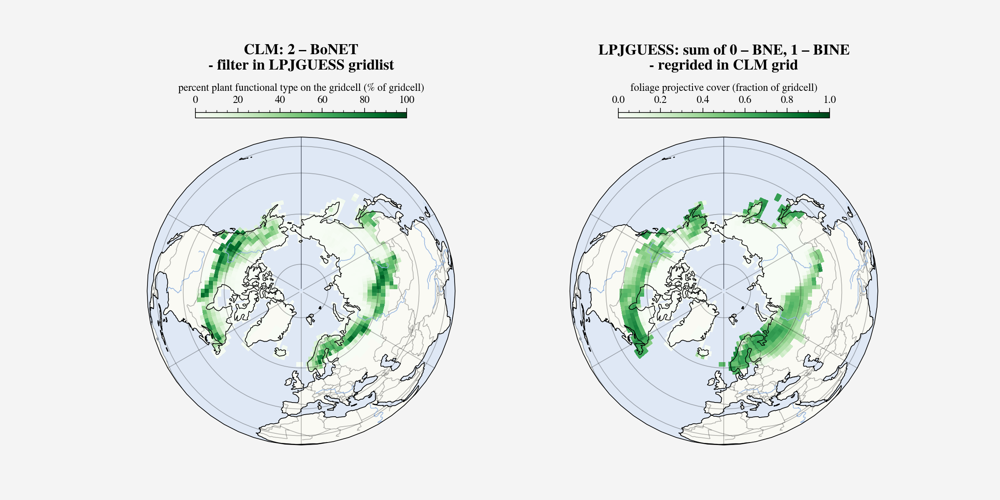

In [109]:
fig, axs = plt.subplots(ncols=2, figsize=[12,6],subplot_kw={'projection': ccrs.Orthographic(0,90)})

single_pft_map(pfts_CLM_area.sel(natpft=2),vmax=100, ax=axs[0],
              title = "CLM: 2 – BoNET\n- filter in LPJGUESS gridlist")

single_pft_map(pfts_coarse.sel(natpft=[0,1]).sum('natpft',keep_attrs=True, skipna=False),
                 title = "LPJGUESS: sum of 0 – BNE, 1 – BINE\n- regrided in CLM grid", vmax=1., ax=axs[1])

Overall the pattern seems similarly reproduced, but some intensity differences occure - LPJGUESS looks lower than CLM

### <span style="color:DarkCyan "> b. Arctic C3 grass = combination of LPJGUESS pfts

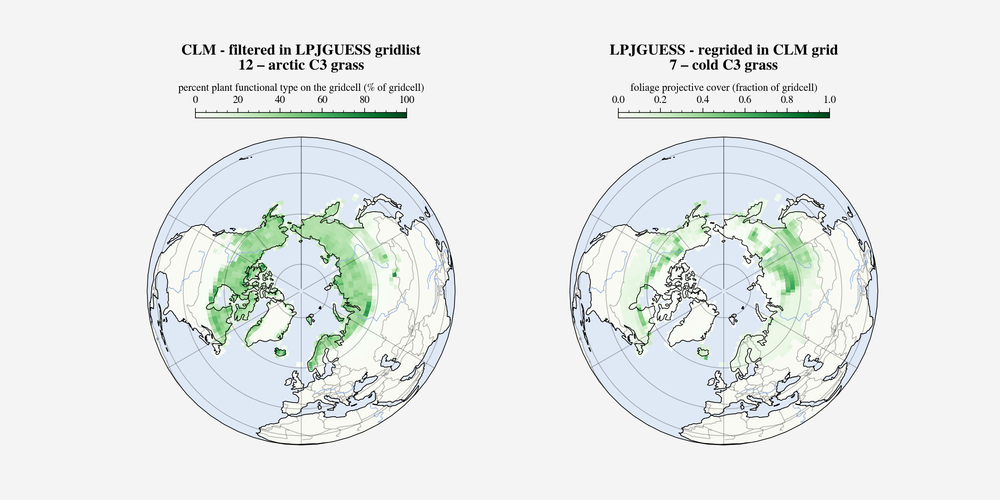

In [110]:
fig, axs = plt.subplots(ncols=2, figsize=[12,6],subplot_kw={'projection': ccrs.Orthographic(0,90)})


#single_pft_map(pfts_CLM_sel.sel(natpft=12),ax=axs[0], title = "CLM\n12 – arctic C3 grass")

single_pft_map(pfts_CLM_area.sel(natpft=12), ax=axs[0],
              title = "CLM - filtered in LPJGUESS gridlist\n12 – arctic C3 grass", vmax=100)

#single_pft_map(pfts_coarse.sel(natpft=[7,12,13,14,15,16,17,18,19,20,21,22]).sum('natpft').where(pfts_coarse.sel(natpft=0)>=0.),
                 #title = "LPJGUESS - regrided in CLM grid\n sum of [7,12-22]", vmax=1., figsize = [6,6])

#single_pft_map(pfts_coarse.sel(natpft=[7,12,13,14,15,16,17,18,19,21,22]).sum('natpft').where(pfts_coarse.sel(natpft=0)>=0.),
                # title = "LPJGUESS - regrided in CLM grid\n sum of [7,12-22] but 20 - pmoss", vmax=1., figsize = [6,6])

single_pft_map(pfts_coarse.sel(natpft=[7]).sum('natpft', skipna=False), ax=axs[1],
                 title = "LPJGUESS - regrided in CLM grid\n7 – cold C3 grass", vmax=1.)
               #\n sum of [7,12-22] but 12 - GRT, 19 - WetGRS, 20 - pmoss", vmax=1., figsize = [6,6])

Grass in general looks widely spread in the region, but in LPJGUESS seems more concentrated in certain areas, while CLM looks more homogenous.

### <span style="color:DarkCyan "> c. BoBDS (CLM shrub) = combinations of LPJGUESS pfts

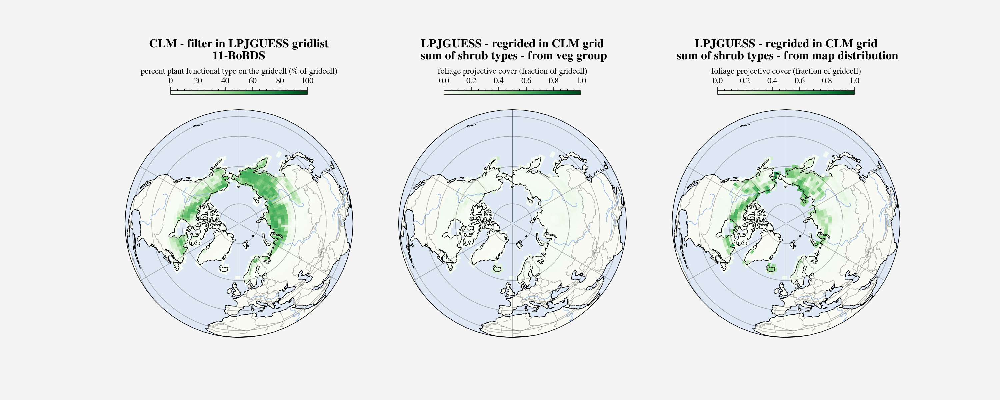

In [111]:
fig, axs = plt.subplots(ncols=3, figsize=[15,6],subplot_kw={'projection': ccrs.Orthographic(0,90)})

single_pft_map(pfts_CLM_area.sel(natpft=11), ax = axs[0],
              title = "CLM - filter in LPJGUESS gridlist\n11-BoBDS", vmax=100)

single_pft_map(pfts_coarse.sel(natpft=[8,9,10,11]).sum('natpft', skipna=False),
               title = "LPJGUESS - regrided in CLM grid\n sum of shrub types - from veg group", vmax=1.,
               ax = axs[1])

single_pft_map(pfts_coarse.sel(natpft=[8,9,10,11,12,13, 14,15]).sum('natpft', skipna=False),
                 title = "LPJGUESS - regrided in CLM grid\n sum of shrub types - from map distribution", 
               vmax=1., ax = axs[2])

At the end, shrubs and grass in LPJGUESS look underestimated compared to CLM. Any hypothesis is that CLM considers shrubs and grass some components that in LPJGUESS are modelled as peatland. 
Checking the peatland fraction though, the pattern of the this latter fraction does not exactly corresponds to the "missing" values from grass and shrubs. So this is not a confirmation of the hypothesis, but we still can't exclude it, since the models are different in assumptions, parametrizations, approximations...

## Final comparison scheme*

*To check on future projections if the approximations can still apply (ex: IBS)*

At the end of the analysis, we make the following assumptions:
- IBS considered 100% boreal since it's on this gridlist, we make this approximation (while TeBS <-> TeBDT) $\rightarrow$ to check
- All L. shrub types are summed into the C. boreal type (many are close to 0, so they don't affect the total)
- GRT-EPDS-SPDS-CLM are considered shrub type in CLM -> gets closer but not perfect

In [112]:
# Convertion scheme is (L->C):
# 3 -> 1
# 0,1 -> 2
# 2 -> 3
# 4 -> 5
# 6 -> 7 in this grid selection
# 5 -> 8
# 8,10 -> 11? in this grid selection
# 9, 11,12,13,14,15 -> 11
# 7 -> 12

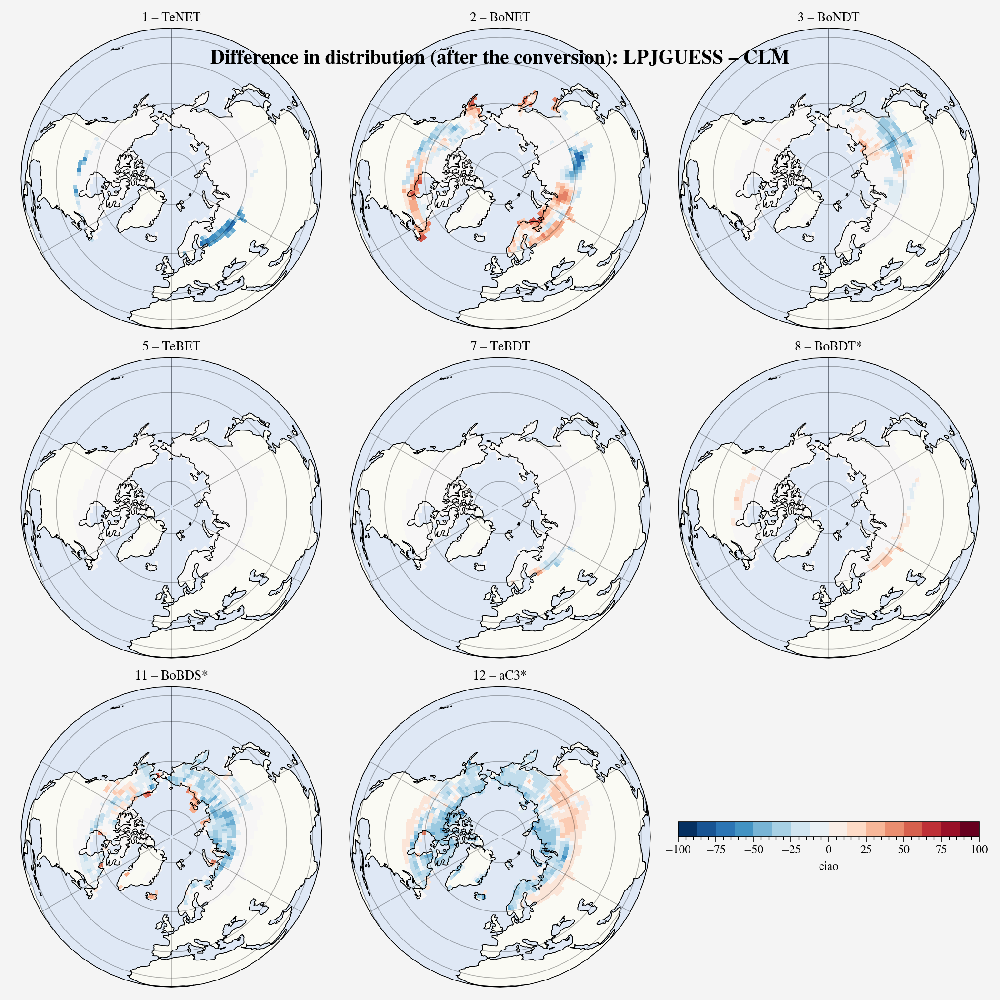

In [113]:
pfts_converted = PFT_convert_LPJGUESS_to_CLM(CLM_pfts = pfts_CLM_sel, LPJGUESS_pfts = pfts_coarse)

"""
plot_boreal_pfts(pfts_converted, col_wrap=3, vmax=100.,
                 title = "LPJGUESS data converted into CLM PFT classification",
                titles = ["1 – TeNET","2 – BoNET","3 – BoNDT", "5 – TeBET", "7 – TeBDT", 
                "8 – BoBDT", "11 – BoBDS","12 – aC3"])
"""

diff_pfts = (pfts_converted-pfts_CLM_area)

plot_boreal_pfts(diff_pfts, col_wrap=3, vmin=-100,vmax=100., cmap='burd', levels = 16,
                 title = "Difference in distribution (after the conversion): LPJGUESS – CLM",
                titles = ["1 – TeNET","2 – BoNET","3 – BoNDT", "5 – TeBET", "7 – TeBDT", "8 – BoBDT*", 
                           "11 – BoBDS*","12 – aC3*"])

We can then see some differences in reproducing the correspondant PFTs. Overall LPJGUESS PFTs seem underestimated compared to the respective CLM ones. Wide unexpected location-dependent difference [-80%,60%]in the boreal needleleaved evergreen tree. While the large difference [-40%, +30%] in shrubs and grass can be due to the fact that CLM hasn't implemented the peatland pfts and can take some of them into count.

## Replacement of LPJGUESS data in the CLM5 surfdata file

*Note: there is a single value that after the regriding exceed 100 (natpft=2, lat=69.16, lon=35.). Probably linked all the manipulation: 1. regrid LPJ grid to CLM grid, 2. sum of BNE+BINE in a single pft 3. convert into lndgrid*

In [19]:
# Rescale on landunit (CLM is in landunit)
pfts_converted_lndunit = convert_gridcell_to_landunit(pfts_converted, lnd_frac, 
                                                      attrs=dict(long_name = pfts_CLM.long_name))

#Note there is a single value that after the regriding exceed 100 (natpft=2, lat=69.16, lon=35.)
#Pribably linked all the manipulation: 1. regrid LPJ grid to CLM grid, 
#2. sum of BNE+BINE in a single pft 3. convert into lndgrid
#Fix manually
pfts_converted_lndunit = pfts_converted_lndunit.where(pfts_converted_lndunit<=100., 100.).where(pfts_converted_lndunit>=0.)
# Import original file
fn_in='surfdata_1.9x2.5_hist_78pfts_CMIP6_simyr2000_c190304'
fn = '../../data/surfdatamap/'+fn_in + '.nc'
dset_in = xr.open_dataset(fn)
# Load a CLM DataArray (from previous analysis)
pfts_CLM = xr.open_dataset(folder_out+'IDEALIZED/pfts_CLM.nc'); pfts_CLM = pfts_CLM.PCT_NAT_PFT

# Apply modification to the original surfdata map
ds = surfdatamap_modification(original_ds = dset_in, pfts_tot = pfts_CLM, edited_pfts = pfts_converted_lndunit, method = 'irregular_area')
# Save the new edited surfdatafile
ds.load().to_netcdf(folder_out+'REALISTIC/'+fn_in+'_historical.nc')

Allert convert_to_lsmcoord! Changing from coord to dim means loosing information and changing from values to indexes


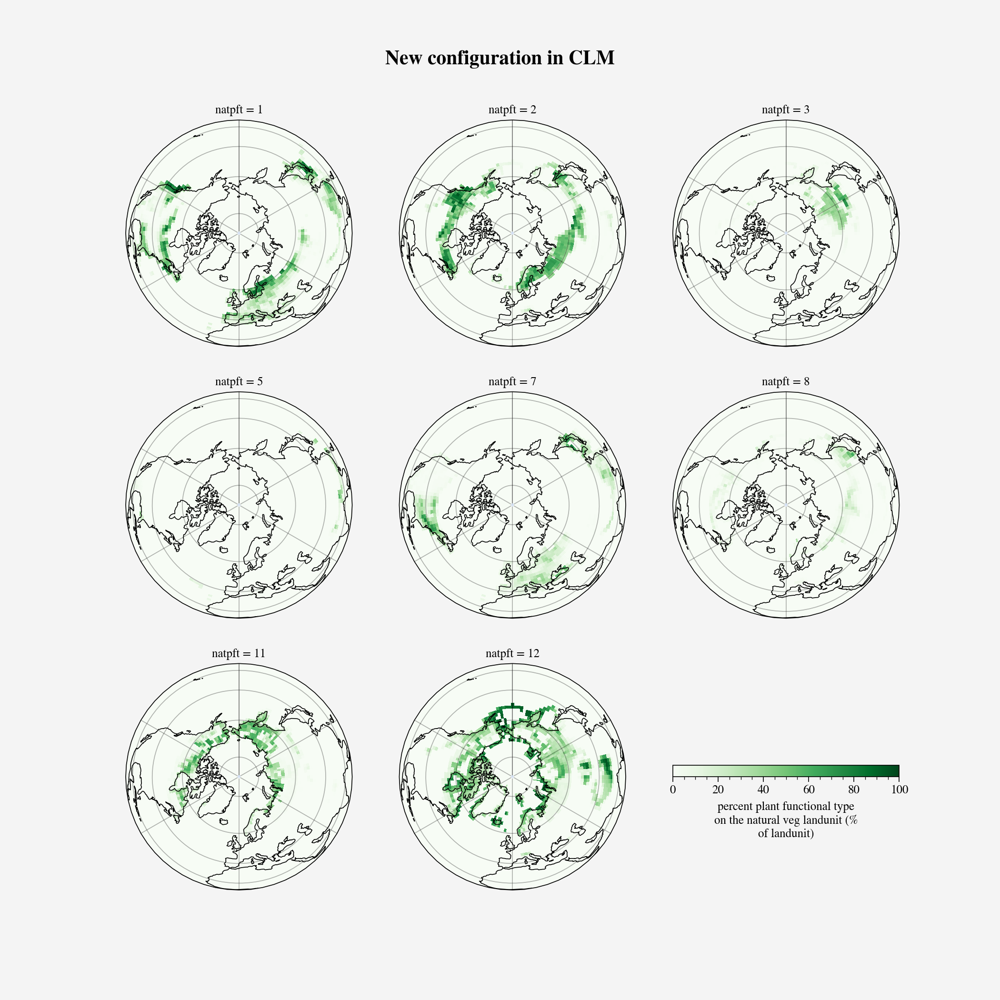

In [20]:
e = convert180_360(convert_lsmcoord(ds)).PCT_NAT_PFT.sel(natpft=[1,2,3,5,7,8,11,12])
plot_boreal_pfts(e, title ="New configuration in CLM", col_wrap=3)

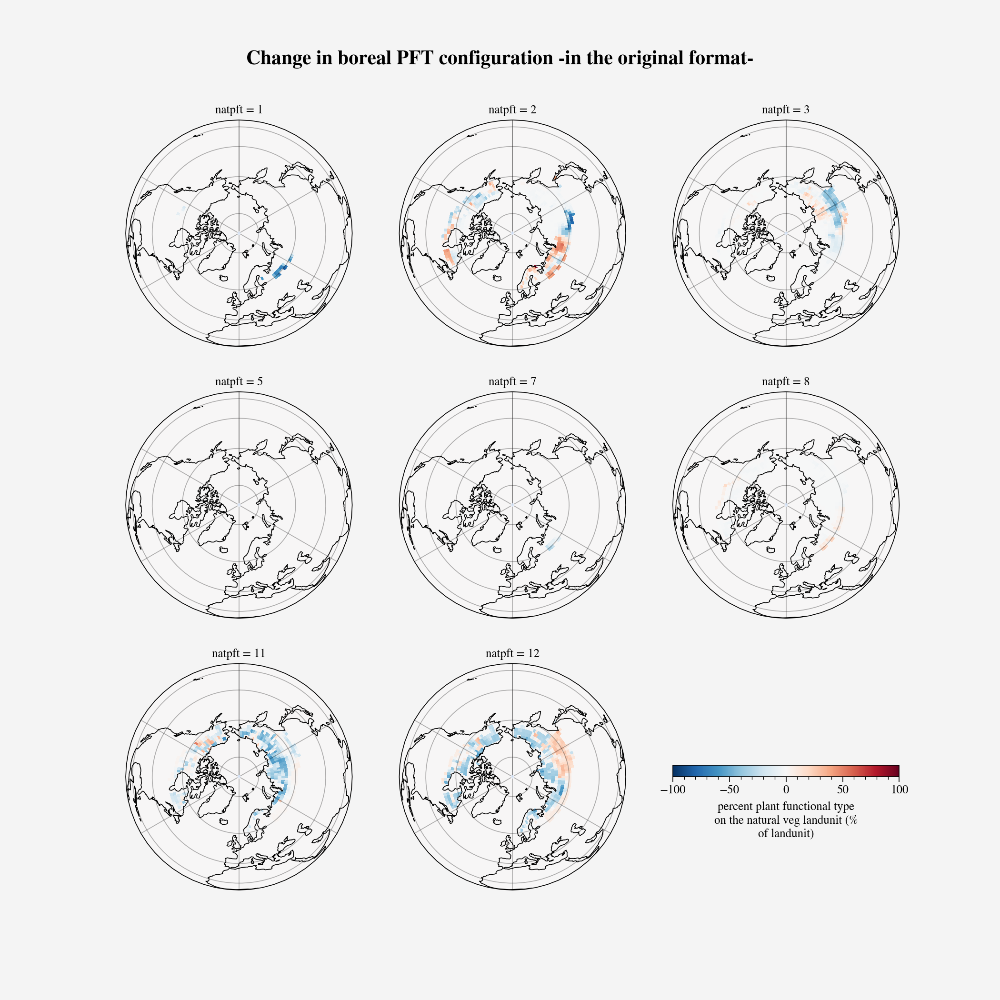

In [21]:
d = convert180_360(convert_lsmcoord(dset_in)).PCT_NAT_PFT.sel(natpft=[1,2,3,5,7,8,9,11,12])
plot_boreal_pfts((e-d), title ="Change in boreal PFT configuration -in the original format-", 
                 cmap='burd',col_wrap=3)

### Check if also after the convertion difference is the same

In [22]:
check_da_equal((e-d),diff_pfts.fillna(0.))

The DataArrays are different. Check NaN values


In [23]:
c = (((e-d)*lnd_frac)-(diff_pfts.fillna(0.)))
c.where(c==c.min(), drop=True).squeeze()

<xarray.DataArray ()>
array(-7.34426303)
Coordinates:
    lon      float64 35.0
    natpft   int64 2
    lat      float64 69.16
Attributes:
    long_name:  percent plant functional type on the natural veg landunit (% ...
    units:      unitless

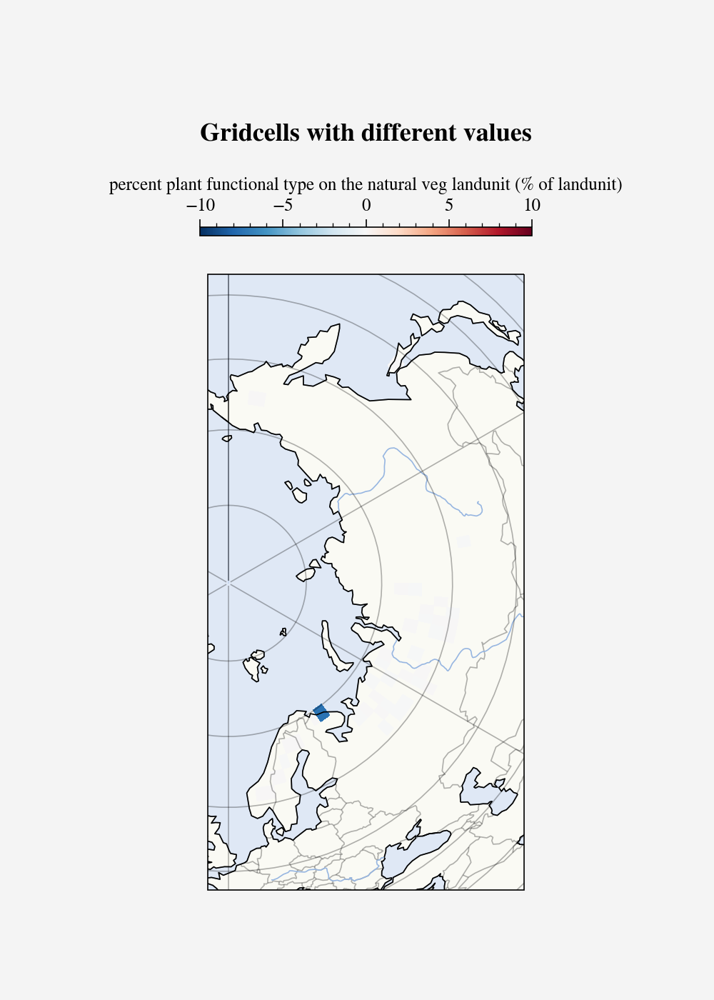

In [24]:
single_pft_map((((e-d)*lnd_frac)-(diff_pfts.fillna(0.))).where(((e-d)*lnd_frac)!=(diff_pfts.fillna(0.)), drop=True).sel(natpft=2), 
                 title ="Gridcells with different values", cmap='burd',vmin=-10,vmax=10., figsize=[5,7])

The only problematic point is exactly the one I manually edited. Good!

## <div class="alert alert-success">Appendix A: Difference covered area per PFT</div>

The final purpose is to replace LPJGUESS data over CLM surfdata file. It is then interesting to visualize what is the data left untouched by the replacement. Data is selected over latitude = 45 °N.

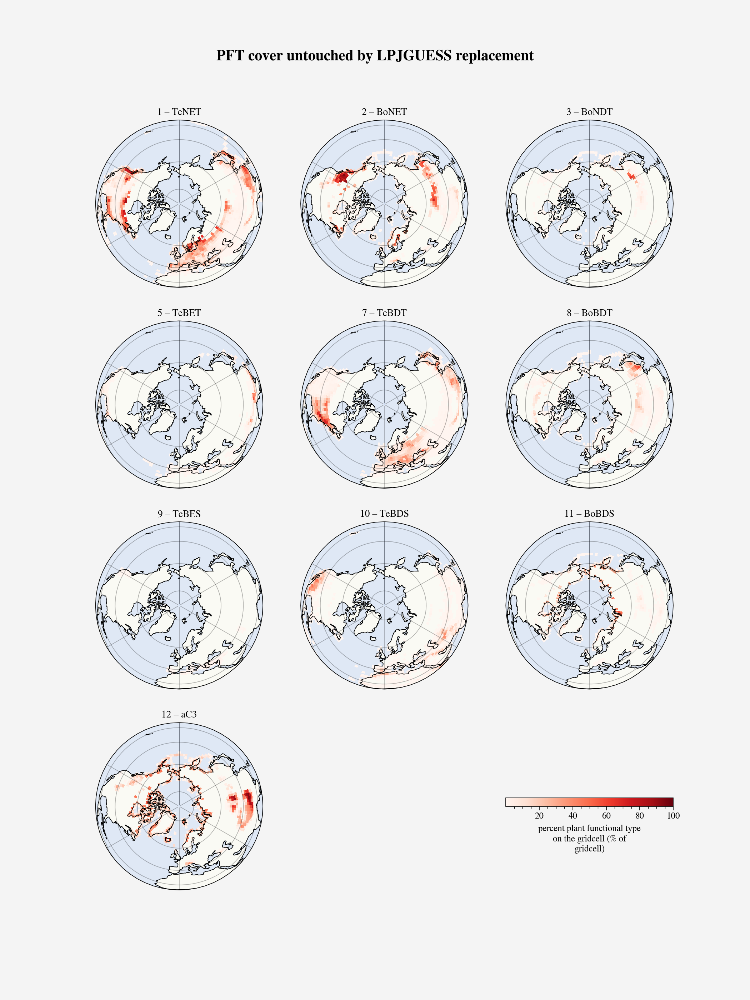

In [25]:
pfts_coarse = match_coord(pfts, pfts_CLM_sel)
da = pfts_CLM_sel.copy()
da.values = pfts_CLM_sel.fillna(0.) - pfts_CLM_sel.where(pfts_coarse>=0.).fillna(0.)
plot_boreal_pfts(da.where(da>0.),title = "PFT cover untouched by LPJGUESS replacement", 
                 vmax=100, cmap='Reds', col_wrap=3,
                 titles = ["1 – TeNET","2 – BoNET","3 – BoNDT", "5 – TeBET", "7 – TeBDT", "8 – BoBDT", 
                           "9 – TeBES", "10 – TeBDS","11 – BoBDS","12 – aC3"])

## <div class="alert alert-success">Appendix B: peatland PFTs of LPJGUESS</div>
### <span style="color:DarkSlateGray">Focus on most relevant peatland PFTs in LPJGUESS VS possible correspondant PFTs in CLM</span>

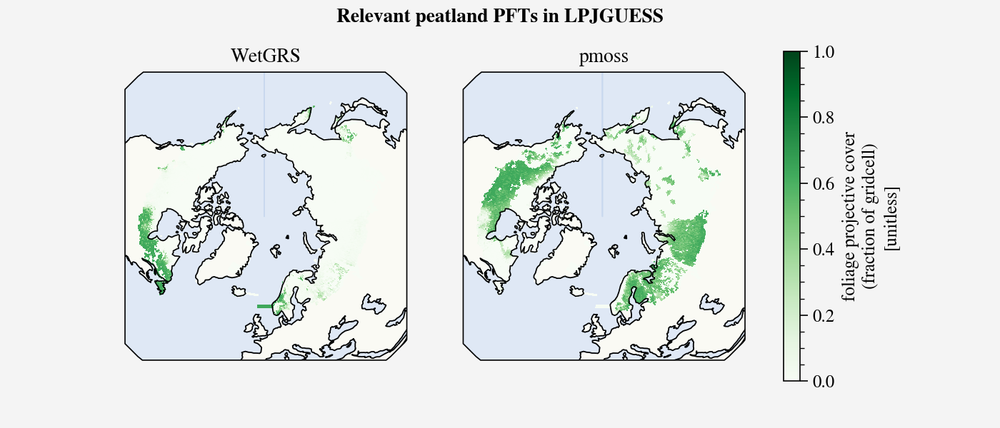

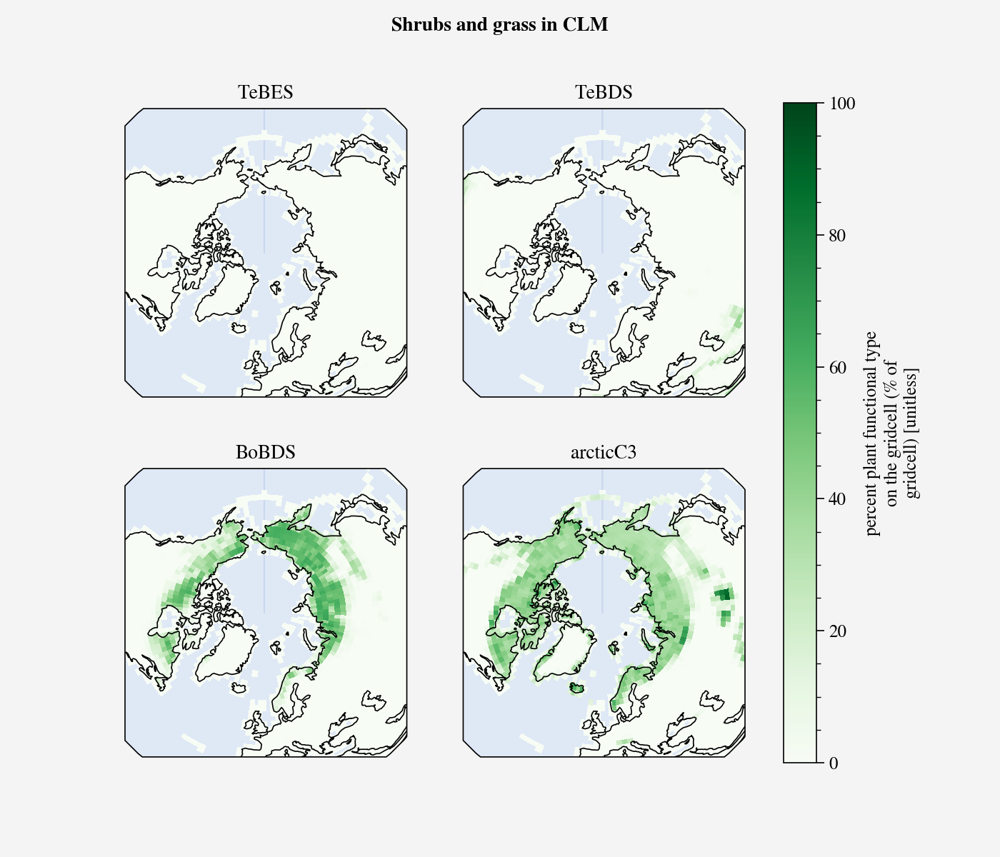

In [26]:
# Plot of most relevant peatland PFTs in LPJGUESS
basic_pft_map(pfts.sel(natpft=[19,20]), title='Relevant peatland PFTs in LPJGUESS', 
              titles = [pftnames[key] for key in [19,20]], vmax=1, col_wrap=2,
              proj=ccrs.Orthographic(0,90))

# Plot of tentative correspondant PFTs in CLM
basic_pft_map(pfts_CLM_norm.sel(natpft=[9,10,11,12]), title='Shrubs and grass in CLM', 
              titles = [pftnames_CLM.get(key) for key in [9,10,11,12]], vmax=100,
              proj=ccrs.Orthographic(0,90), col_wrap=2)

As we can see from the plots, there is no clear evidence of a correspondance.
This confirms that CLM5 doesn't have peatland PFTs implemented, as LPJGUESS instead.
Having checked that, a further doubt is if there is any need of renormalization of LPJGUESS PFTs if it considers peatland PFTs in the sum.

### <span style="color:DarkSlateGray">Normalization of the peatland fraction: natural and peatland sum in LPJGUESS </span>

In order to check the nromalization, we import directly the sums from the original file, where (from `Readme!.rtf`):
- *Natural_sum*: summed FPC fro natural fraction
- *Peatland_sum*: summed FPC for peatland fraction
- *Total*: total FPC for each grid cell

The values of the first two columns multiplied with grid cell landcover fractions (i.e., Natural and peatland fractions) give us the `Total` FPC. The landcover fractions is in the provided file: `lpj_global_gridlist_with_peatfrac.txt`.

We then compare to the sum over all PFTs (not normalized with landcover fraction):
- *All_PFTs_sum*: summed FPC for both natural and peatland fractions

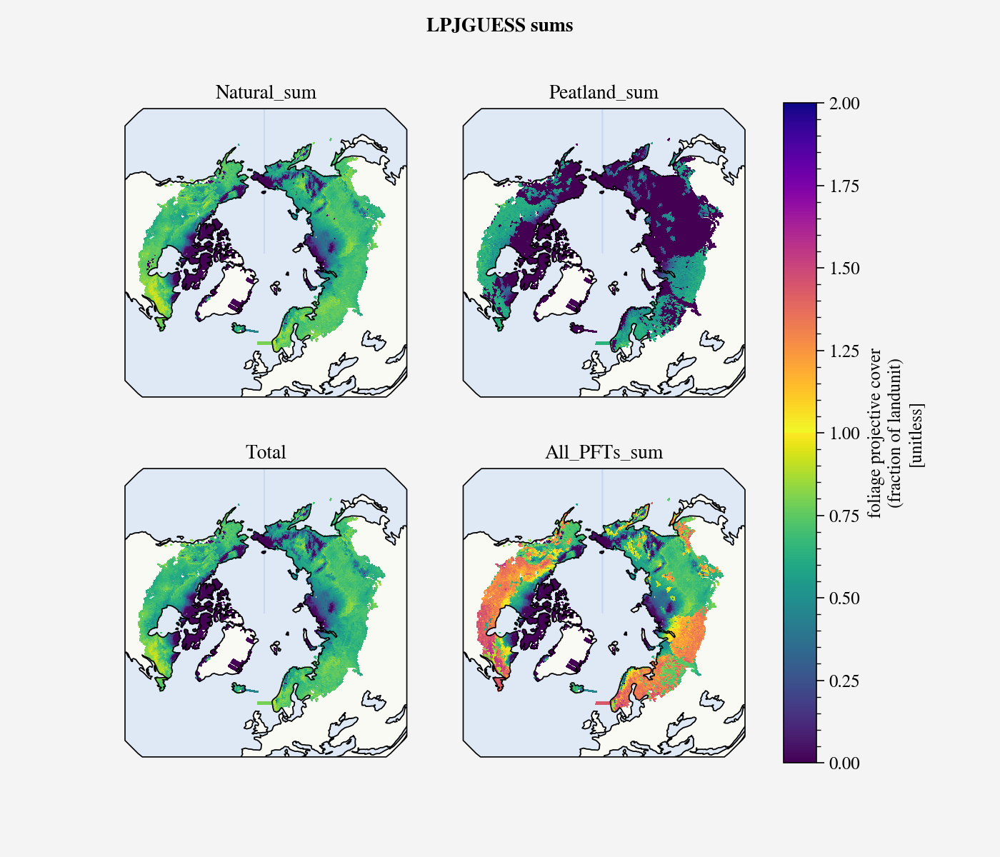

In [27]:
pftstot_da=DataArray_from_LPJGUESS(fn_path, total = True, name='FPC_PFT', colnames=True, da_attrs=pfts_CLM,
                               main_attrs = {'long_name': 'foliage projective cover (fraction of landunit)'})
# Add to the DataArray the sum of all PFTs (natural+peatland)
da_sum = pftstot_da.isel(natpft=[-2,-1]).sum('natpft').where(pftstot_da.isel(natpft=0)>=0.)
da_sum = da_sum.assign_coords({"natpft":'All_PFTs_sum'}).expand_dims('natpft')
pftstot_da = pftstot_da.isel(natpft=[-2,-1, -3])
pftstot_da = xr.concat((pftstot_da, da_sum), dim='natpft')

# Create a representative colormap
colors_norm = plt.cm.viridis(np.linspace(0, 1, 256))
colors_over = plt.cm.plasma_r(np.linspace(0,1, 256))
all_colors = np.vstack((colors_norm, colors_over))
natpeat_cmap = mpl.colors.LinearSegmentedColormap.from_list('natpeat_cmap', all_colors)
divnorm = mpl.colors.TwoSlopeNorm(vmin=0., vcenter=1., vmax=2.)

# Plot of natural and peatland PFTs in LPJGUESS
basic_pft_map(pftstot_da, title='LPJGUESS sums', cmap=natpeat_cmap, norm=divnorm, 
              titles = list(pftstot_da.natpft.values), col_wrap=2,
              proj=ccrs.Orthographic(0,90))#, figsize=[11.5,4])


We can notice how the Natural and Peatland fractions are independent in summing up to the maximum value of 1 - `All_PFTs_sum` should match with `Total`, but each fraction is multiplied by the land fraction (see below). We can than conclude that for further comparison with CLM, we will just consider the natural fraction.

### <span style="color:DarkSlateGray">Land fraction in LPJGUESS: relative quantification of natural and peatland fractions over the covered area </span>



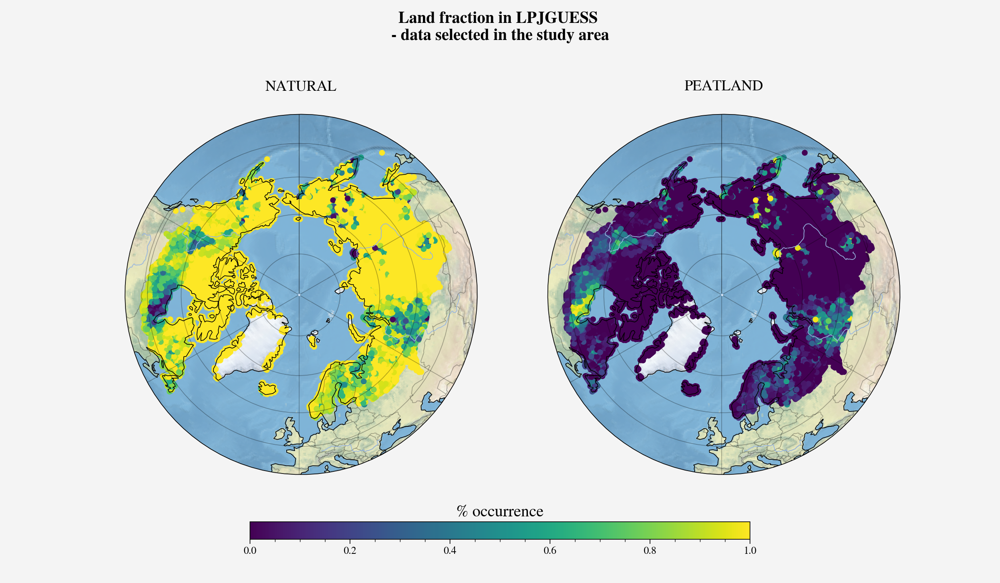

In [28]:
# Import data
fn = 'lpj_global_gridlist_with_peatfrac.txt'
lndcover = pd.read_csv(foldername+fn, sep="\t")
fn = 'gridlist45N_tundraboreal.txt'
lonlat = pd.read_csv(foldername+fn, sep="\t", header=None)
lonlat.columns = ['Lon', 'Lat']

# Select data in lonlat list
df_tot = filter_lonlat(lndcover, lonlat)

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, subplot_kw={'projection': ccrs.Orthographic(0, 90)}, figsize = [12,7])
cut_extent_Orthographic(ax1, lat=40)
df_tot.plot.scatter(ax=ax1, x='Lon', y='Lat', c='NATURAL', cmap='viridis', transform = ccrs.PlateCarree(),colorbar=False)
ax_map_properties(ax1, earth=True)
ax1.set_title('NATURAL',y=1.05,size='x-large')

cut_extent_Orthographic(ax2, lat=40)
df_tot.plot.scatter(ax=ax2, x='Lon', y='Lat', c=lndcover.columns[3], cmap='viridis', transform = ccrs.PlateCarree(),colorbar=False)
ax_map_properties(ax2, earth=True)
ax2.set_title('PEATLAND',y=1.05,size='x-large')

cbar_ax = fig.add_axes([0.25, 0.075, 0.5, 0.03]) #[left, bottom, width, height]
cbar=fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=1), cmap=mpl.cm.viridis), cax=cbar_ax ,orientation='horizontal')
cbar.ax.set_title('% occurrence', size = 14 )
plt.suptitle("Land fraction in LPJGUESS \n- data selected in the study area", size = 14 )
plt.show()

## <div class="alert alert-success">Appendix C: latitude distribution comparison overlook</div>
    
For matching the indexes refers to the above table.

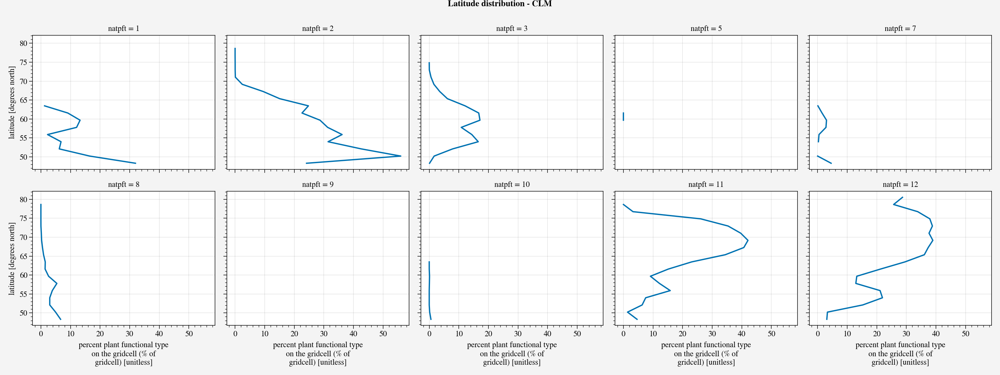

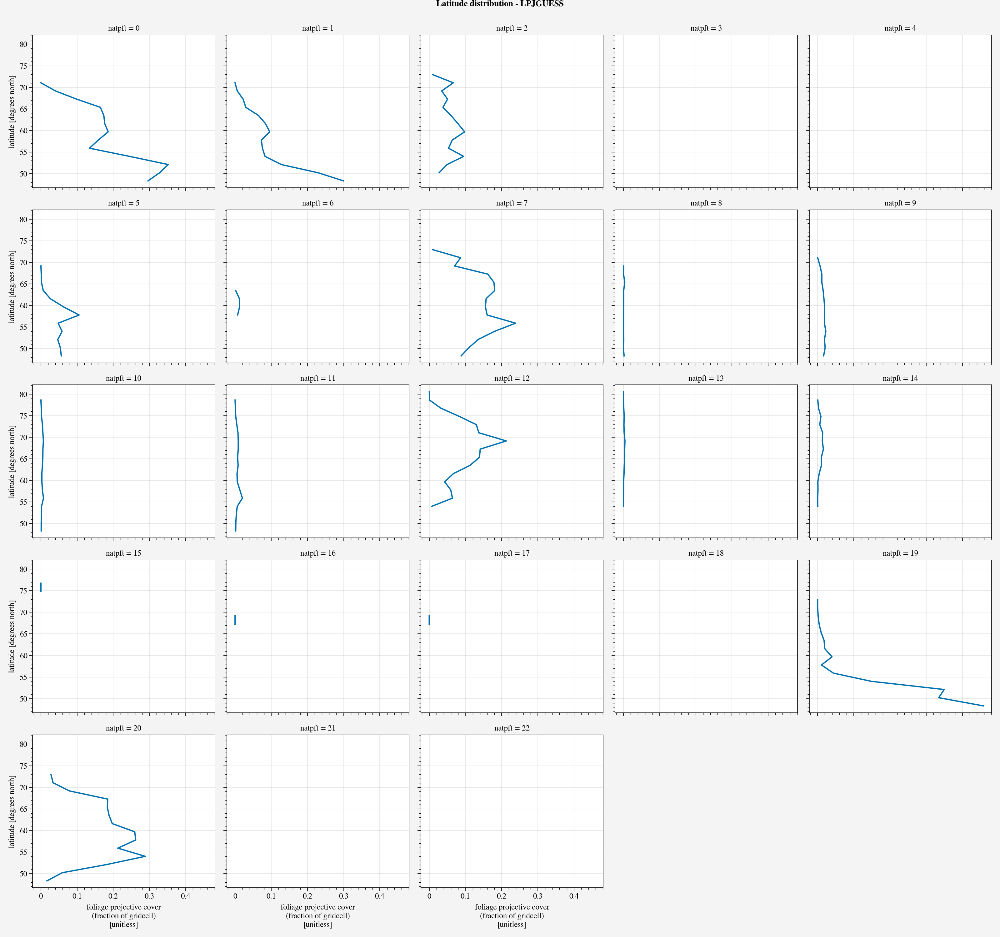

In [29]:
boreal_lat=45.

c = pfts_CLM_area.sel(lat=slice(boreal_lat,90)).mean('lon')
c.where(c>0.).plot(y='lat',col='natpft', col_wrap=5)
plt.suptitle("Latitude distribution - CLM", y=1)
plt.tight_layout()
plt.show()

c = pfts_coarse.sel(lat=slice(boreal_lat,90)).mean('lon')
c.where(c>0.).plot(y='lat',col='natpft', col_wrap=5)
plt.suptitle("Latitude distribution - LPJGUESS", y=1)
plt.tight_layout()
plt.show()